<a href="https://colab.research.google.com/github/h-youssef26/crossborderinternetanalysis/blob/main/Discussion_Notebook_visual_19_(1).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### **Installation is essential **

In [1]:
pip install rasterio geopandas pandas shapely

In [2]:
!pip install geopandas

In [7]:
!pip install adjustText

### **Import all the Libraries needed**

In [3]:
%matplotlib inline

from datetime import datetime

import geopandas as gpd
import matplotlib
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

from shapely.geometry import Point
from adjustText import adjust_text

Metadata: The file name SVDNB_npp_20230101-20230131_00N060E_vcmcfg_v10_c202302080600.avg_rade9h provides important metadata that can help understand the contents of the file. Let's break it down:

File Name Breakdown:
SVDNB:

This likely refers to "Suomi National Polar-orbiting Partnership (Suomi NPP)". Suomi NPP is a satellite operated by NASA and NOAA that collects environmental data. Specifically, SVDNB refers to the Day/Night Band (DNB) on the VIIRS sensor onboard the Suomi NPP satellite, which is used to observe nighttime lights.
npp:

Refers to the Suomi National Polar-orbiting Partnership (NPP) mission, which is a collaboration between NASA, NOAA, and other agencies for environmental monitoring.
20230101-20230131:

The date range for the data. The data collected here corresponds to the period from January 1, 2023, to January 31, 2023.
00N060E:

This is likely the location or region of interest. The coordinates 00N060E represent a location at 0° latitude (equator) and 60° longitude (East), somewhere in the Indian Ocean.
This information indicates that the data pertains to a specific geographic area or grid covering that region.
vcmcfg_v10:

VCM Configuration: This likely refers to the VIIRS Cloud Mask (VCM) Configuration version 10, which is used for identifying clouds in satellite imagery.
This could be part of the processing steps to exclude cloud-covered areas from the nighttime lights data.
c202302080600:

This appears to be a timestamp in the format cYYYYMMDDHHMM, where:
c is a prefix for the date and time.
2023-02-08 06:00 refers to February 8, 2023, at 06:00 UTC. This timestamp likely indicates when the data was processed or when the file was generated.
avg_rade9h:

This likely indicates the averaged radiance values over a 9-hour period (the rade9h suffix suggests radiance averaged over a 9-hour window).
This could represent a temporal aggregation of nighttime light data to smooth out fluctuations in light intensity.
Summary of Information Derived from the File Name:
The file contains nighttime light data from the Suomi NPP satellite (using the VIIRS sensor), collected between January 1, 2023, and January 31, 2023, for a specific geographic region near the equator (0°N, 60°E). The data is processed with cloud masking (vcmcfg_v10) and represents average radiance values (avg_rade9h) over a 9-hour period. The file was generated on February 8, 2023.



# **Extract viris Data for Brazil**

In [4]:
import rasterio
import geopandas as gpd
from rasterio.mask import mask
from shapely.geometry import box
import numpy as np
import pandas as pd

raster_files = {
    '2023-07': '/content/SVDNB_npp_20230701-20230726_00N060W_vcmcfg_v10_c202308111200.avg_rade9h.tif',
    '2023-08': '/content/SVDNB_npp_20230801-20230831_00N060W_vcmcfg_v10_c202309131200.avg_rade9h.tif',
    '2023-09': '/content/SVDNB_npp_20230901-20230930_00N060W_vcmcfg_v10_c202310101000.avg_rade9h.tif'
}

boundary_file = r'/content/geoBoundaries-BRA-ADM2.geojson'
output_csv =  r'/content/Brazil_light_intensity.csv'

brazil = gpd.read_file(boundary_file)
brazil = brazil.to_crs(epsg=4326)
brazil_geom_list = list(brazil.geometry)

all_data = []

for month, raster_file in raster_files.items():
    print(f"Processing month: {month}")
    with rasterio.open(raster_file) as src:
        raster_bounds = box(*src.bounds)
        print("Raster Bounds:", src.bounds)
        print("Brazil Bounds:", brazil.total_bounds)

        if not raster_bounds.intersects(brazil.geometry.union_all()):
            raise ValueError(f"Brazil's boundary does not overlap raster extent for {month}")

        clipped_raster, clipped_transform = mask(src, brazil_geom_list, crop=True, nodata=np.nan)

    light_intensity = clipped_raster[0]
    rows, cols = np.where(~np.isnan(light_intensity))
    values = light_intensity[rows, cols]
    x_coords, y_coords = rasterio.transform.xy(clipped_transform, rows, cols)

    data = pd.DataFrame({
        'longitude': x_coords,
        'latitude': y_coords,
        'light_intensity': values,
        'month': month
    })

    all_data.append(data)

final_data = pd.concat(all_data, ignore_index=True)
final_data.to_csv(output_csv, index=False)

print(f"Extracted {len(final_data)} light intensity points from 3 months. Saved to {output_csv}")

Processing month: 2023-07
Raster Bounds: BoundingBox(left=-60.00208333335, bottom=-64.99791718665, right=59.99791762665001, top=0.00208333335)
Brazil Bounds: [-73.99047852 -33.75079346 -28.84918213   5.27111816]
Processing month: 2023-08
Raster Bounds: BoundingBox(left=-60.00208333335, bottom=-64.99791718665, right=59.99791762665001, top=0.00208333335)
Brazil Bounds: [-73.99047852 -33.75079346 -28.84918213   5.27111816]
Processing month: 2023-09
Raster Bounds: BoundingBox(left=-60.00208333335, bottom=-64.99791718665, right=59.99791762665001, top=0.00208333335)
Brazil Bounds: [-73.99047852 -33.75079346 -28.84918213   5.27111816]
Extracted 90675657 light intensity points from 3 months. Saved to /content/Brazil_light_intensity.csv


# **Read the output file which is the viris data for Brazil**


In [5]:
import pandas as pd

df_brazil = pd.read_csv(r"/content/Brazil_light_intensity.csv")
print(len(df_brazil))
df_brazil.head()

90675657


,longitude,latitude,light_intensity,month
0,-60.000000,0.0,0.21,2023-07
1,-59.995833,0.0,0.21,2023-07
2,-59.991667,0.0,0.20,2023-07
3,-59.987500,0.0,0.21,2023-07
4,-59.983333,0.0,0.23,2023-07


### **preprocessing for the Data to Remove the Zeros from the lat and lang**

In [6]:
df = df_brazil[(df_brazil['latitude'] != 0) & (df_brazil['longitude'] != 0)]

In [7]:
print(len(df))

90667992


In [8]:
df.head()

,longitude,latitude,light_intensity,month
2555,-60.000000,-0.004167,0.23,2023-07
2556,-59.995833,-0.004167,0.18,2023-07
2557,-59.991667,-0.004167,0.22,2023-07
2558,-59.987500,-0.004167,0.25,2023-07
2559,-59.983333,-0.004167,0.25,2023-07


### **Transfer viris the lang and lat to polygon **

In [9]:
import pandas as pd
import numpy as np
from shapely.geometry import Polygon

In [10]:
def create_polygon_from_point(lon, lat, cell_size=0.004167):

    half_size = cell_size / 2
    corners = [
        (lon - half_size, lat + half_size),
        (lon + half_size, lat + half_size),
        (lon + half_size, lat - half_size),
        (lon - half_size, lat - half_size),
        (lon - half_size, lat + half_size)
    ]
    return Polygon(corners)

def convert_points_to_polygons(virus_df):

    virus_polygons_df_brazil = virus_df.copy()

    virus_polygons_df_brazil['geometry'] = virus_polygons_df_brazil.apply(
        lambda row: create_polygon_from_point(row['longitude'], row['latitude']),
        axis=1
    )

    return gpd.GeoDataFrame(virus_polygons_df_brazil, geometry='geometry', crs='EPSG:4326')

In [ ]:
virus_polygons_df_brazil = convert_points_to_polygons(df)
print(virus_polygons_df_brazil.head())

In [ ]:
output2_csv = r'/content/Brazil_with_polygon_light_intensity.csv'
virus_polygons_df_brazil.to_csv(output2_csv, index=False)
print(f"Extracted data saved to {output2_csv}")

Extracted data saved to /content/Brazil_with_polygon_light_intensity.csv


In [ ]:
virus_polygons_df_brazil.head()

,longitude,latitude,light_intensity,month,geometry
0,-60.000000,-24.037500,0.19,2023-07,"POLYGON ((-60.00208 -24.03542, -59.99792 -24.0..."
1,-59.995833,-24.037500,0.17,2023-07,"POLYGON ((-59.99792 -24.03542, -59.99375 -24.0..."
2,-60.000000,-24.041667,0.20,2023-07,"POLYGON ((-60.00208 -24.03958, -59.99792 -24.0..."
3,-59.995833,-24.041667,0.26,2023-07,"POLYGON ((-59.99792 -24.03958, -59.99375 -24.0..."
4,-59.991667,-24.041667,0.26,2023-07,"POLYGON ((-59.99375 -24.03958, -59.98958 -24.0..."


# **Extract viris Data for Argentina**

In [ ]:
import rasterio
import geopandas as gpd
from rasterio.mask import mask
from shapely.geometry import box
import numpy as np
import pandas as pd
import os


raster_files = {
    '2023-07': '/content/SVDNB_npp_20230701-20230726_00N060W_vcmcfg_v10_c202308111200.avg_rade9h.tif',
    '2023-08': '/content/SVDNB_npp_20230801-20230831_00N060W_vcmcfg_v10_c202309131200.avg_rade9h.tif',
    '2023-09': '/content/SVDNB_npp_20230901-20230930_00N060W_vcmcfg_v10_c202310101000.avg_rade9h.tif'
}

boundary_file = r'/content/geoBoundaries-VEN-ADM0.geojson'
output_csv = r'/content/Venezuela_light_intensity.csv'

argentina = gpd.read_file(boundary_file)
argentina = argentina.to_crs(epsg=4326)
argentina_geom_list = list(argentina.geometry)

all_data = []

for month, raster_file in raster_files.items():
    if not os.path.exists(raster_file):
        print(f"File missing for {month}: {raster_file}")
        continue
    print(f"Processing month: {month}")

    with rasterio.open(raster_file) as src:
        raster_bounds = box(*src.bounds)
        print("Raster Bounds:", src.bounds)
        print("Argentina Bounds:", argentina.total_bounds)

        if not raster_bounds.intersects(argentina.geometry.union_all()):
            raise ValueError(f"Argentina's boundary does not overlap raster extent for {month}")

        clipped_raster, clipped_transform = mask(src, argentina_geom_list, crop=True, nodata=np.nan)

    light_intensity = clipped_raster[0]
    rows, cols = np.where(~np.isnan(light_intensity))
    values = light_intensity[rows, cols]
    x_coords, y_coords = rasterio.transform.xy(clipped_transform, rows, cols)

    data = pd.DataFrame({
        'longitude': x_coords,
        'latitude': y_coords,
        'light_intensity': values,
        'month': month
    })

    all_data.append(data)

Processing month: 2023-07
Raster Bounds: BoundingBox(left=-60.00208333335, bottom=-64.99791718665, right=59.99791762665001, top=0.00208333335)
Argentina Bounds: [-73.56658936 -55.06352234 -53.63736944 -21.78113479]
Processing month: 2023-08
Raster Bounds: BoundingBox(left=-60.00208333335, bottom=-64.99791718665, right=59.99791762665001, top=0.00208333335)
Argentina Bounds: [-73.56658936 -55.06352234 -53.63736944 -21.78113479]
Processing month: 2023-09
Raster Bounds: BoundingBox(left=-60.00208333335, bottom=-64.99791718665, right=59.99791762665001, top=0.00208333335)
Argentina Bounds: [-73.56658936 -55.06352234 -53.63736944 -21.78113479]


# **Read the output file which is the viris data for Argentina**


In [ ]:
import pandas as pd

df_argentina = pd.read_csv(r"/content/Venezuela_light_intensity.csv")
print(len(df_argentina))
df_argentina.head()

6443133


,longitude,latitude,light_intensity,month
0,-60.000000,-24.037500,0.19,2023-07
1,-59.995833,-24.037500,0.17,2023-07
2,-60.000000,-24.041667,0.20,2023-07
3,-59.995833,-24.041667,0.26,2023-07
4,-59.991667,-24.041667,0.26,2023-07


### **preprocessing for the Data to Remove the Zeros from the lat and lang**

In [ ]:
df = df_argentina[(df_argentina['latitude'] != 0) & (df_argentina['longitude'] != 0)]

In [ ]:
print(len(df))

6443133


In [ ]:
df.head()

,longitude,latitude,light_intensity,month
0,-60.000000,-24.037500,0.19,2023-07
1,-59.995833,-24.037500,0.17,2023-07
2,-60.000000,-24.041667,0.20,2023-07
3,-59.995833,-24.041667,0.26,2023-07
4,-59.991667,-24.041667,0.26,2023-07


### **Transfer viris the lang and lat to polygon **

In [ ]:
from shapely.geometry import Polygon
import geopandas as gpd
import pandas as pd

def create_polygon_from_point(lon, lat, cell_size=0.004167):
    half_size = cell_size / 2
    corners = [
        (lon - half_size, lat + half_size),
        (lon + half_size, lat + half_size),
        (lon + half_size, lat - half_size),
        (lon - half_size, lat - half_size),
        (lon - half_size, lat + half_size)
    ]
    return Polygon(corners)

def convert_points_to_polygons(virus_df):
    virus_polygons_df = virus_df.copy()
    virus_polygons_df['geometry'] = virus_polygons_df.apply(
        lambda row: create_polygon_from_point(row['longitude'], row['latitude']),
        axis=1
    )
    return gpd.GeoDataFrame(virus_polygons_df, geometry='geometry', crs='EPSG:4326')


In [ ]:
virus_polygons_df = convert_points_to_polygons(df_argentina)

print("\nExample of converted data:")
print(virus_polygons_df.head())


Example of converted data:
   longitude   latitude  light_intensity    month  \
0 -60.000000 -24.037500             0.19  2023-07   
1 -59.995833 -24.037500             0.17  2023-07   
2 -60.000000 -24.041667             0.20  2023-07   
3 -59.995833 -24.041667             0.26  2023-07   
4 -59.991667 -24.041667             0.26  2023-07   

                                            geometry  
0  POLYGON ((-60.00208 -24.03542, -59.99792 -24.0...  
1  POLYGON ((-59.99792 -24.03542, -59.99375 -24.0...  
2  POLYGON ((-60.00208 -24.03958, -59.99792 -24.0...  
3  POLYGON ((-59.99792 -24.03958, -59.99375 -24.0...  
4  POLYGON ((-59.99375 -24.03958, -59.98958 -24.0...  


In [ ]:
output3_csv = r'/content/Venezuela_with_polygon_light_intensity.csv'
virus_polygons_df.to_csv(output3_csv, index=False)
print(f"Extracted data saved to {output3_csv}")

Extracted data saved to /content/Argentina_with_polygon_light_intensity.csv


In [ ]:
virus_polygons_df.head()

,longitude,latitude,light_intensity,month,geometry
0,-60.000000,-24.037500,0.19,2023-07,"POLYGON ((-60.00208 -24.03542, -59.99792 -24.0..."
1,-59.995833,-24.037500,0.17,2023-07,"POLYGON ((-59.99792 -24.03542, -59.99375 -24.0..."
2,-60.000000,-24.041667,0.20,2023-07,"POLYGON ((-60.00208 -24.03958, -59.99792 -24.0..."
3,-59.995833,-24.041667,0.26,2023-07,"POLYGON ((-59.99792 -24.03958, -59.99375 -24.0..."
4,-59.991667,-24.041667,0.26,2023-07,"POLYGON ((-59.99375 -24.03958, -59.98958 -24.0..."


In [ ]:
print(len(virus_polygons_df))

6443133


### **Ookla Data for Brazil and Argentina**

In [ ]:
%matplotlib inline

from datetime import datetime

import geopandas as gpd
import matplotlib
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

from shapely.geometry import Point
from adjustText import adjust_text

In [ ]:
def quarter_start(year: int, q: int) -> datetime:
    if not 1 <= q <= 4:
        raise ValueError("Quarter must be within [1, 2, 3, 4]")

    month = [1, 4, 7, 10]
    return datetime(year, month[q - 1], 1)


def get_tile_url(service_type: str, year: int, q: int) -> str:
    dt = quarter_start(year, q)

    base_url = "https://ookla-open-data.s3-us-west-2.amazonaws.com/shapefiles/performance"
    url = f"{base_url}/type%3D{service_type}/year%3D{dt:%Y}/quarter%3D{q}/{dt:%Y-%m-%d}_performance_{service_type}_tiles.zip"
    return url

In [ ]:
tile_url = get_tile_url("fixed", 2023, 3)
tile_url

'https://ookla-open-data.s3-us-west-2.amazonaws.com/shapefiles/performance/type%3Dfixed/year%3D2023/quarter%3D3/2023-07-01_performance_fixed_tiles.zip'

In [ ]:
tiles = gpd.read_file(tile_url)

In [ ]:
tiles.head(10)

,quadkey,avg_d_kbps,avg_u_kbps,avg_lat_ms,tests,devices,geometry
0,0022123130022032,12061,10413,104,1,1,"POLYGON ((-163.81714 71.25318, -163.81165 71.2..."
1,0022133222312322,70906,12258,101,6,2,"POLYGON ((-160.02686 70.64359, -160.02136 70.6..."
2,0022133222330023,143519,19747,115,9,3,"POLYGON ((-160.04333 70.63631, -160.03784 70.6..."
3,0022133222330030,191315,17754,140,11,3,"POLYGON ((-160.03784 70.63813, -160.03235 70.6..."
4,0022133222330031,6011,11396,89,1,1,"POLYGON ((-160.03235 70.63813, -160.02686 70.6..."
5,0022133222330032,109806,10315,121,4,2,"POLYGON ((-160.03784 70.63631, -160.03235 70.6..."
6,0022133222330100,223543,17520,87,1,1,"POLYGON ((-160.02686 70.64177, -160.02136 70.6..."
7,0022133222330201,221039,22007,81,2,2,"POLYGON ((-160.04333 70.63448, -160.03784 70.6..."
8,0022133222330210,140205,13638,104,2,2,"POLYGON ((-160.03784 70.63448, -160.03235 70.6..."
9,0022302121020200,85,1217,92,1,1,"POLYGON ((-166.99219 69.37257, -166.98669 69.3..."


### **preprocessing for Ookla**

In [ ]:
ookla_data = tiles.dropna()

ookla_data = ookla_data[(ookla_data['avg_d_kbps'] > 0) & (ookla_data['avg_u_kbps'] > 0) & (ookla_data['avg_lat_ms'] > 0)]

print(ookla_data.describe())

         avg_d_kbps    avg_u_kbps    avg_lat_ms         tests       devices
count  6.667840e+06  6.667840e+06  6.667840e+06  6.667840e+06  6.667840e+06
mean   1.391479e+05  6.768822e+04  2.494166e+01  1.661886e+01  5.080563e+00
std    1.451105e+05  9.461067e+04  5.999185e+01  5.693275e+01  1.326413e+01
min    1.000000e+00  1.000000e+00  1.000000e+00  1.000000e+00  1.000000e+00
25%    2.944600e+04  1.098500e+04  8.000000e+00  1.000000e+00  1.000000e+00
50%    8.582500e+04  3.042800e+04  1.400000e+01  4.000000e+00  2.000000e+00
75%    2.132142e+05  8.710000e+04  2.400000e+01  1.300000e+01  4.000000e+00
max    3.227104e+06  2.892535e+06  2.984000e+03  6.232000e+04  1.794000e+03


In [ ]:
ookla_data.head()

,quadkey,avg_d_kbps,avg_u_kbps,avg_lat_ms,tests,devices,geometry
0,0022123130022032,12061,10413,104,1,1,"POLYGON ((-163.81714 71.25318, -163.81165 71.2..."
1,0022133222312322,70906,12258,101,6,2,"POLYGON ((-160.02686 70.64359, -160.02136 70.6..."
2,0022133222330023,143519,19747,115,9,3,"POLYGON ((-160.04333 70.63631, -160.03784 70.6..."
3,0022133222330030,191315,17754,140,11,3,"POLYGON ((-160.03784 70.63813, -160.03235 70.6..."
4,0022133222330031,6011,11396,89,1,1,"POLYGON ((-160.03235 70.63813, -160.02686 70.6..."


### **Intgrate the 2 datasets Using polygon Field for Brazil**

In [ ]:
import geopandas as gpd

ookla_with_latandlang = gpd.sjoin(tiles, virus_polygons_df, how="inner", predicate="intersects")

print(ookla_with_latandlang.head(10))

                  quadkey  avg_d_kbps  avg_u_kbps  avg_lat_ms  tests  devices  \
6038758  2103010323112233        4864       19125          23      2        1   
6038758  2103010323112233        4864       19125          23      2        1   
6038758  2103010323112233        4864       19125          23      2        1   
6038758  2103010323112233        4864       19125          23      2        1   
6038758  2103010323112233        4864       19125          23      2        1   
6038758  2103010323112233        4864       19125          23      2        1   
6038758  2103010323112233        4864       19125          23      2        1   
6038758  2103010323112233        4864       19125          23      2        1   
6038758  2103010323112233        4864       19125          23      2        1   
6038758  2103010323112233        4864       19125          23      2        1   

                                                  geometry  index_right  \
6038758  POLYGON ((-59.83704 -24.

In [ ]:
counties = gpd.read_file(r"/content/geoBoundaries-BRA-ADM2.geojson")
counties.head()

,shapeName,shapeISO,shapeID,shapeGroup,shapeType,geometry
0,Alta Floresta D'Oeste,,56859067B53124283675112,BRA,ADM2,"POLYGON ((-62.0495 -11.86731, -62.05359 -11.86..."
1,Ariquemes,,56859067B41513078802850,BRA,ADM2,"POLYGON ((-62.42279 -9.80481, -62.42468 -9.801..."
2,Cabixi,,56859067B41778865724378,BRA,ADM2,"POLYGON ((-60.70929 -13.69299, -60.70959 -13.6..."
3,Cacoal,,56859067B12179645667792,BRA,ADM2,"POLYGON ((-61.00061 -10.99219, -61.37201 -10.9..."
4,Cerejeiras,,56859067B66697352879536,BRA,ADM2,"POLYGON ((-60.74298 -13.12238, -60.74829 -13.1..."


In [ ]:
gdf = gpd.GeoDataFrame(ookla_with_latandlang, geometry='geometry')

ookal_verss_cities = gpd.sjoin(gdf, counties, how='inner', predicate='intersects', lsuffix='_left', rsuffix='_right')

grouped = ookal_verss_cities.groupby('shapeName').agg({
    'avg_d_kbps': 'mean',
    'avg_u_kbps': 'mean',
    'avg_lat_ms': 'mean',
    'tests': 'sum',
    'devices': 'sum',
    'light_intensity': 'mean'
}).reset_index()


In [ ]:
grouped.head()

,shapeName,avg_d_kbps,avg_u_kbps,avg_lat_ms,tests,devices,light_intensity
0,Barracão,158221.875,116533.375,3.50,336,129,16.653333
1,Bom Jesus do Sul,48654.000,56481.000,1.00,3,3,0.476667
2,Capanema,18652.000,13825.000,9.25,15,12,0.358333
3,Crissiumal,11723.000,5381.000,11.00,18,9,0.304444
4,Derrubadas,1131.500,5027.125,50.00,138,24,0.366250


In [ ]:
len(grouped)

20

In [ ]:
Brazil_grouped_city = grouped
Brazil_grouped_city

,shapeName,avg_d_kbps,avg_u_kbps,avg_lat_ms,tests,devices,light_intensity
0,Barracão,158221.875000,116533.375000,3.500000,336,129,16.653333
1,Bom Jesus do Sul,48654.000000,56481.000000,1.000000,3,3,0.476667
2,Capanema,18652.000000,13825.000000,9.250000,15,12,0.358333
3,Crissiumal,11723.000000,5381.000000,11.000000,18,9,0.304444
4,Derrubadas,1131.500000,5027.125000,50.000000,138,24,0.366250
5,Dionísio Cerqueira,171292.909091,148949.090909,9.000000,630,192,12.327576
6,Doutor Maurício Cardoso,8469.000000,4525.000000,7.000000,108,12,0.447500
7,Esperança do Sul,2623.250000,1337.500000,33.000000,15,12,0.421667
8,Foz do Iguaçu,50838.357143,47800.750000,33.964286,1602,801,18.596429
9,Itapiranga,6443.700000,2870.450000,17.050000,78,60,0.271000


In [ ]:
final_output_csv = r'/content/Brazil_Final.csv'
grouped.to_csv(final_output_csv, index=False)
print(f"Extracted data saved to {final_output_csv}")

Extracted data saved to /content/Brazil_Final.csv


### **Intgrate the 2 datasets Using polygon Field for Argentina:**

In [ ]:
import geopandas as gpd

ookla_with_latandlang = gpd.sjoin(tiles, virus_polygons_df, how="inner", predicate="intersects")

print(ookla_with_latandlang.head())

                  quadkey  avg_d_kbps  avg_u_kbps  avg_lat_ms  tests  devices  \
6038758  2103010323112233        4864       19125          23      2        1   
6038758  2103010323112233        4864       19125          23      2        1   
6038758  2103010323112233        4864       19125          23      2        1   
6038758  2103010323112233        4864       19125          23      2        1   
6038758  2103010323112233        4864       19125          23      2        1   

                                                  geometry  index_right  \
6038758  POLYGON ((-59.83704 -24.28202, -59.83154 -24.2...      2151018   
6038758  POLYGON ((-59.83704 -24.28202, -59.83154 -24.2...         3307   
6038758  POLYGON ((-59.83704 -24.28202, -59.83154 -24.2...         3201   
6038758  POLYGON ((-59.83704 -24.28202, -59.83154 -24.2...      4298729   
6038758  POLYGON ((-59.83704 -24.28202, -59.83154 -24.2...      4298623   

         longitude   latitude  light_intensity    month  
6038

In [ ]:
counties = gpd.read_file(r"/content/geoBoundaries-VEN-ADM0.geojson")
counties.head()

,shapeName,shapeISO,shapeID,shapeGroup,shapeType,geometry
0,Arauco,,61730980B43357395590927,ARG,ADM2,"POLYGON ((-66.35296 -28.73289, -66.35298 -28.7..."
1,Tres Arroyos,,61730980B62269269094219,ARG,ADM2,"POLYGON ((-59.83498 -38.23132, -59.83506 -38.2..."
2,El Carmen,,61730980B76568954927707,ARG,ADM2,"POLYGON ((-65.14063 -24.33221, -65.14072 -24.3..."
3,Pinamar,,61730980B99310691740446,ARG,ADM2,"POLYGON ((-56.90898 -37.18885, -56.90895 -37.1..."
4,General Pinto,,61730980B27788441407365,ARG,ADM2,"POLYGON ((-61.71047 -34.62683, -61.76956 -34.5..."


In [ ]:
gdf = gpd.GeoDataFrame(ookla_with_latandlang, geometry='geometry')

ookal_verss_cities = gpd.sjoin(gdf, counties, how='inner', predicate='intersects', lsuffix='_left', rsuffix='_right')

grouped = ookal_verss_cities.groupby('shapeName').agg({
    'avg_d_kbps': 'mean',
    'avg_u_kbps': 'mean',
    'avg_lat_ms': 'mean',
    'tests': 'sum',
    'devices': 'sum',
    'light_intensity': 'mean'
}).reset_index()


In [ ]:
grouped.head()

,shapeName,avg_d_kbps,avg_u_kbps,avg_lat_ms,tests,devices,light_intensity
0,1ro. de Mayo,14816.865079,8750.888889,29.253968,1812,618,16.145370
1,25 de Mayo,13956.778378,6823.437838,49.156757,3057,819,5.832396
2,Adolfo Gonzáles Chaves,19640.000000,5737.000000,21.000000,24,24,0.423333
3,Almirante Brown,135125.066112,82598.302644,13.061214,93252,30462,62.702236
4,Apostoles,5936.600000,1261.857143,42.742857,1776,348,22.234286


In [ ]:
len(grouped)

167

In [ ]:
Argentina_grouped_city = grouped
Argentina_grouped_city

,shapeName,avg_d_kbps,avg_u_kbps,avg_lat_ms,tests,devices,light_intensity
0,1ro. de Mayo,14816.865079,8750.888889,29.253968,1812,618,16.145370
1,25 de Mayo,13956.778378,6823.437838,49.156757,3057,819,5.832396
2,Adolfo Gonzáles Chaves,19640.000000,5737.000000,21.000000,24,24,0.423333
3,Almirante Brown,135125.066112,82598.302644,13.061214,93252,30462,62.702236
4,Apostoles,5936.600000,1261.857143,42.742857,1776,348,22.234286
...,...,...,...,...,...,...,...
162,Vicente López,153343.076336,56950.264631,13.194656,200862,63402,84.368923
163,Victoria,28008.500000,59836.500000,36.000000,36,36,0.525000
164,Villa Gesell,22582.931641,7087.265625,15.765625,15246,6024,23.873366
165,Villaguay,25970.552448,12272.601399,18.727273,1614,777,43.684452


In [ ]:
final1_output_csv = r'/content/Venezuela_Final.csv'
grouped.to_csv(final1_output_csv, index=False)
print(f"Extracted data saved to {final1_output_csv}")

Extracted data saved to /content/Argentina_Final.csv


### **Intgrate the 2 datasets Using polygon Field for Argentina and Brazil**

In [ ]:
import pandas as pd
import geopandas as gpd

brazil = pd.read_csv('/content/Brazil_Final.csv')
argentina = pd.read_csv('/content/Argentina_Final.csv')

brazil['country'] = 'Brazil'
argentina['country'] = 'Argentina'

common_cols = list(set(brazil.columns) & set(argentina.columns))
combined = pd.concat([
    brazil[common_cols],
    argentina[common_cols]
], ignore_index=True)

if all(col in combined.columns for col in ['longitude', 'latitude']):
    gdf_combined = gpd.GeoDataFrame(
        combined,
        geometry=gpd.points_from_xy(combined.longitude, combined.latitude),
        crs='EPSG:4326'
    )
else:
    gdf_combined = gpd.GeoDataFrame(combined)

gdf_combined.to_csv('/content/Brazil_Argentina_Integrated.csv', index=False)

In [ ]:
df = pd.read_csv('/content/Brazil_Argentina_Integrated.csv')
print("\nRandom 5 records:")
display(df.sample(5))


Random 5 records:


,avg_d_kbps,avg_lat_ms,devices,tests,country,avg_u_kbps,shapeName,light_intensity
5099,231118.763441,2.795699,137,246,Brazil,169914.784946,Westfália,2.964839
1445,162076.333333,3.226190,120,388,Brazil,155551.702381,Dom Pedro de Alcântara,1.308571
2296,134072.614525,35.731844,275,1091,Brazil,120252.089385,Jambeiro,3.570223
3439,73110.164589,17.842893,1108,3587,Brazil,68950.985037,Pentecoste,3.128180
24,35488.871287,26.700495,496,2605,Brazil,29961.108911,Acorizal,1.326337


In [ ]:
df = pd.read_csv('/content/Brazil_Argentina_Integrated.csv')
print("\nRecords per country:")
display(df['country'].value_counts())


Records per country:


,count
country,
Brazil,5148
Argentina,167


In [ ]:
df = pd.read_csv('/content/Brazil_Argentina_Integrated.csv')
print(df.columns)


Index(['avg_d_kbps', 'avg_lat_ms', 'devices', 'tests', 'country', 'avg_u_kbps',
       'shapeName', 'light_intensity'],
      dtype='object')


### **Start the visualization**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
Brazil_Argentina_Integrated_data_df = pd.read_csv(r"/content/Brazil_Argentina_Integrated.csv")

In [ ]:
Brazil_Argentina_Integrated_data_df.head(5)

,avg_d_kbps,avg_lat_ms,devices,tests,country,avg_u_kbps,shapeName,light_intensity
0,129037.729282,30.723757,1057,3042,Brazil,98011.107735,Abadia de Goiás,6.978370
1,58208.459184,21.755102,440,1142,Brazil,23119.319728,Abadia dos Dourados,2.090782
2,83240.135879,63.690941,2368,8449,Brazil,43830.891652,Abadiânia,1.874849
3,66354.748140,40.025505,2811,11338,Brazil,63368.487779,Abaetetuba,5.399171
4,121993.733333,31.825926,926,3673,Brazil,59543.388889,Abaeté,10.318519


## **HeatMap**

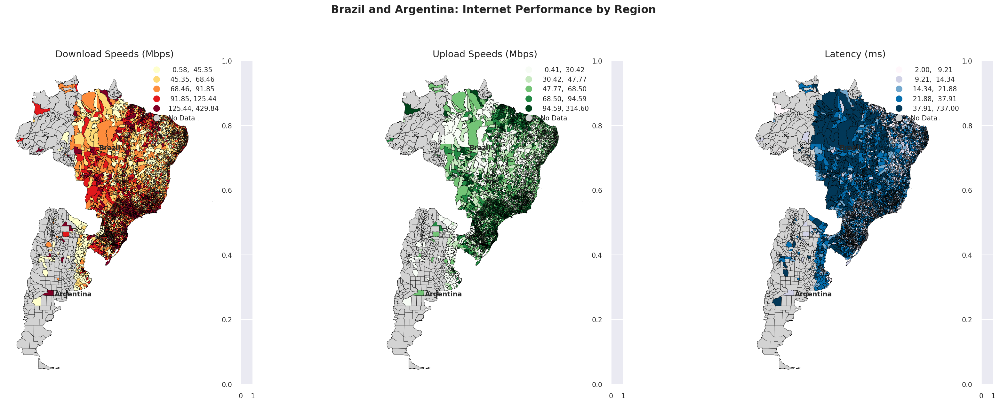

In [ ]:
!pip install mapclassify>=2.4.0

import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable

df = pd.read_csv('/content/Brazil_Argentina_Integrated.csv').copy()
df['avg_d_mbps'] = pd.to_numeric(df['avg_d_kbps'], errors='coerce') / 1000
df['avg_u_mbps'] = pd.to_numeric(df['avg_u_kbps'], errors='coerce') / 1000
df['avg_lat_ms'] = pd.to_numeric(df['avg_lat_ms'], errors='coerce')

brazil_gdf = gpd.read_file('/content/geoBoundaries-BRA-ADM2.geojson')
argentina_gdf = gpd.read_file('/content/geoBoundaries-ARG-ADM2.geojson')

brazil_gdf['country'] = 'Brazil'
argentina_gdf['country'] = 'Argentina'

merged_brazil = brazil_gdf.merge(df[df['country'] == 'Brazil'], on=['shapeName', 'country'], how='left')
merged_argentina = argentina_gdf.merge(df[df['country'] == 'Argentina'], on=['shapeName', 'country'], how='left')

combined_gdf = pd.concat([merged_brazil, merged_argentina], ignore_index=True)
combined_gdf = gpd.GeoDataFrame(combined_gdf, geometry='geometry')

fig, axes = plt.subplots(1, 3, figsize=(24, 8))

metrics = [
    ('avg_d_mbps', 'YlOrRd', 'Download Speeds (Mbps)'),
    ('avg_u_mbps', 'Greens', 'Upload Speeds (Mbps)'),
    ('avg_lat_ms', 'PuBu', 'Latency (ms)')
]

for ax, (col, cmap, title) in zip(axes, metrics):
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.1)

    combined_gdf.plot(
        column=col,
        cmap=cmap,
        edgecolor='black',
        linewidth=0.3,
        legend=True,
        ax=ax,
        cax=cax,
        scheme='quantiles',
        missing_kwds={'color': 'lightgrey', 'label': 'No Data'}
    )

    ax.set_title(title, fontsize=14)
    ax.set_axis_off()
    ax.annotate('Brazil', xy=(-55, -10), fontsize=10, weight='bold')
    ax.annotate('Argentina', xy=(-65, -40), fontsize=10, weight='bold')

plt.suptitle('Brazil and Argentina: Internet Performance by Region', y=1.05, fontsize=16, weight='bold')
plt.tight_layout()
plt.show()


## **HeatMap Matrix**

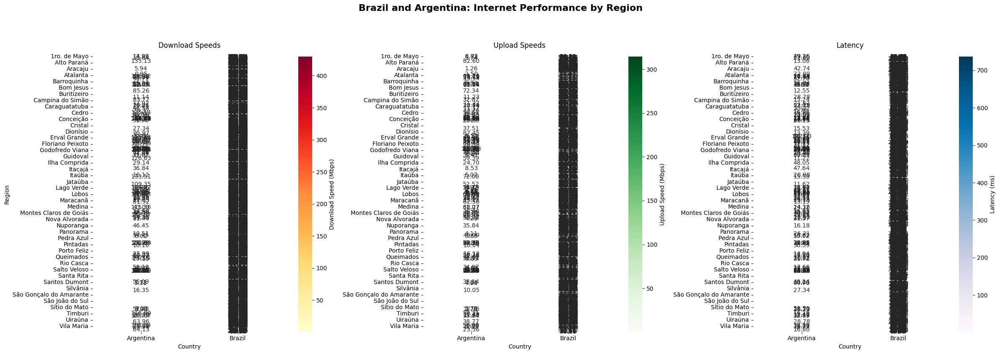

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

df = pd.read_csv('/content/Brazil_Argentina_Integrated.csv').copy()

df['avg_d_mbps'] = pd.to_numeric(df['avg_d_kbps'], errors='coerce') / 1000
df['avg_u_mbps'] = pd.to_numeric(df['avg_u_kbps'], errors='coerce') / 1000
df['avg_lat_ms'] = pd.to_numeric(df['avg_lat_ms'], errors='coerce')

heatmap_data = df.groupby(['shapeName', 'country']).agg({
    'avg_d_mbps': 'mean',
    'avg_u_mbps': 'mean',
    'avg_lat_ms': 'mean'
}).unstack(level=-1)


fig, axes = plt.subplots(1, 3, figsize=(24, 8))

sns.heatmap(
    heatmap_data['avg_d_mbps'],
    cmap='YlOrRd',
    annot=True,
    fmt=".2f",
    linewidths=0.5,
    ax=axes[0],
    cbar_kws={'label': 'Download Speed (Mbps)'}
)
axes[0].set_title('Download Speeds', pad=15)
axes[0].set_xlabel('Country')
axes[0].set_ylabel('Region')

sns.heatmap(
    heatmap_data['avg_u_mbps'],
    cmap='Greens',
    annot=True,
    fmt=".2f",
    linewidths=0.5,
    ax=axes[1],
    cbar_kws={'label': 'Upload Speed (Mbps)'}
)
axes[1].set_title('Upload Speeds', pad=15)
axes[1].set_xlabel('Country')
axes[1].set_ylabel('')

sns.heatmap(
    heatmap_data['avg_lat_ms'],
    cmap='PuBu',
    annot=True,
    fmt=".2f",
    linewidths=0.5,
    ax=axes[2],
    cbar_kws={'label': 'Latency (ms)'}
)
axes[2].set_title('Latency', pad=15)
axes[2].set_xlabel('Country')
axes[2].set_ylabel('')

plt.suptitle('Brazil and Argentina: Internet Performance by Region',
             y=1.05, fontsize=16, weight='bold')
plt.tight_layout()
plt.show()


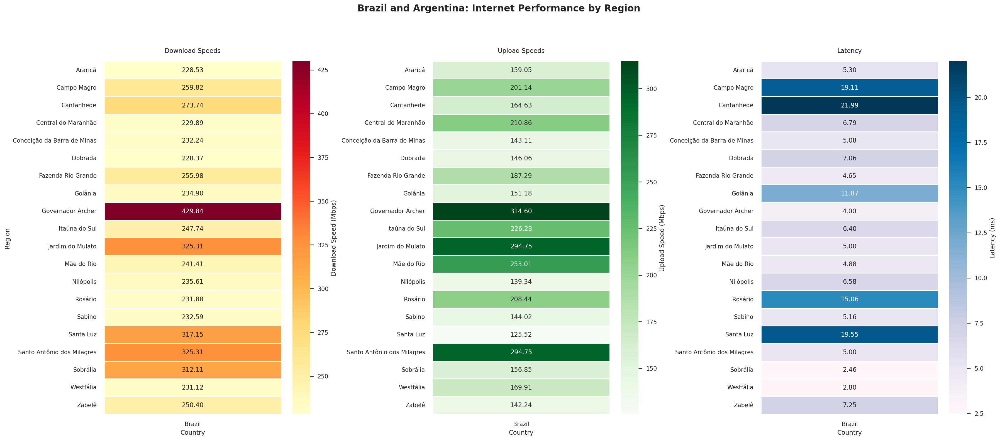

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

df = pd.read_csv('/content/Brazil_Argentina_Integrated.csv').copy()

df['avg_d_mbps'] = pd.to_numeric(df['avg_d_kbps'], errors='coerce') / 1000
df['avg_u_mbps'] = pd.to_numeric(df['avg_u_kbps'], errors='coerce') / 1000
df['avg_lat_ms'] = pd.to_numeric(df['avg_lat_ms'], errors='coerce')

top_regions = df.groupby('shapeName')['avg_d_mbps'].mean().nlargest(20).index.tolist()
filtered_df = df[df['shapeName'].isin(top_regions)].copy()

heatmap_d = filtered_df.pivot_table(index='shapeName', columns='country', values='avg_d_mbps', aggfunc='mean')
heatmap_u = filtered_df.pivot_table(index='shapeName', columns='country', values='avg_u_mbps', aggfunc='mean')
heatmap_lat = filtered_df.pivot_table(index='shapeName', columns='country', values='avg_lat_ms', aggfunc='mean')

fig, axes = plt.subplots(1, 3, figsize=(24, 10))

sns.heatmap(
    heatmap_d,
    cmap='YlOrRd',
    annot=True,
    fmt=".2f",
    linewidths=0.5,
    ax=axes[0],
    cbar_kws={'label': 'Download Speed (Mbps)'}
)
axes[0].set_title('Download Speeds', pad=15)
axes[0].set_xlabel('Country')
axes[0].set_ylabel('Region')

sns.heatmap(
    heatmap_u,
    cmap='Greens',
    annot=True,
    fmt=".2f",
    linewidths=0.5,
    ax=axes[1],
    cbar_kws={'label': 'Upload Speed (Mbps)'}
)
axes[1].set_title('Upload Speeds', pad=15)
axes[1].set_xlabel('Country')
axes[1].set_ylabel('')

sns.heatmap(
    heatmap_lat,
    cmap='PuBu',
    annot=True,
    fmt=".2f",
    linewidths=0.5,
    ax=axes[2],
    cbar_kws={'label': 'Latency (ms)'}
)
axes[2].set_title('Latency', pad=15)
axes[2].set_xlabel('Country')
axes[2].set_ylabel('')

plt.suptitle('Brazil and Argentina: Internet Performance by Region',
             y=1.05, fontsize=16, weight='bold')
plt.tight_layout()
plt.show()


## **2. Line Chart**

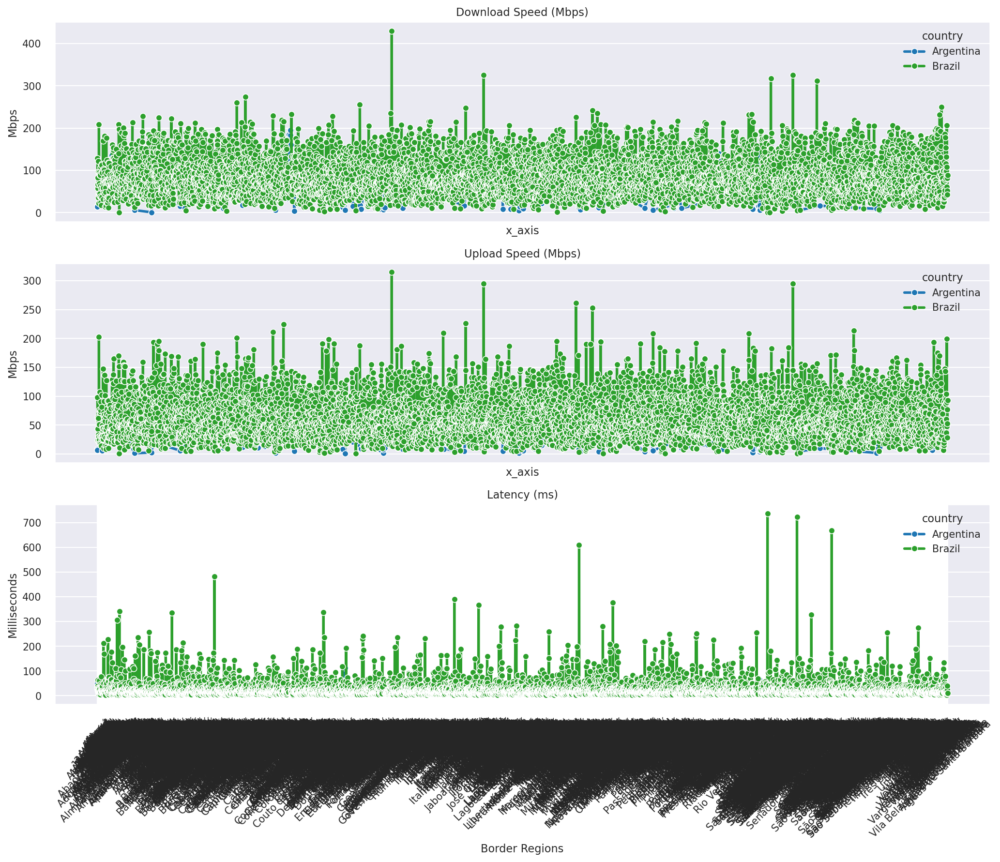

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

df = pd.read_csv('/content/Brazil_Argentina_Integrated.csv').copy()
df['avg_d_mbps'] = df['avg_d_kbps'] / 1000
df['avg_u_mbps'] = df['avg_u_kbps'] / 1000
df['avg_lat_ms'] = pd.to_numeric(df['avg_lat_ms'], errors='coerce')

brazil_regions = df[df['country'] == 'Brazil']['shapeName'].unique().tolist()
argentina_regions = df[df['country'] == 'Argentina']['shapeName'].unique().tolist()

all_regions = list(set(brazil_regions + argentina_regions))

border_df = df[df['shapeName'].isin(all_regions)].copy()

trends = border_df.groupby(['country', 'shapeName']).agg({
    'avg_d_mbps': 'mean',
    'avg_u_mbps': 'mean',
    'avg_lat_ms': 'mean'
}).reset_index()

region_order = sorted(all_regions)

trends['x_axis'] = trends['shapeName'].map({r: i for i, r in enumerate(region_order)})

plt.figure(figsize=(14, 12))
sns.set_style("darkgrid")
palette = {'Brazil': '#2ca02c', 'Argentina': '#1f77b4'}

plt.subplot(3, 1, 1)
sns.lineplot(data=trends, x='x_axis', y='avg_d_mbps',
             hue='country', palette=palette, marker='o', linewidth=2.5)
plt.title('Download Speed (Mbps)')
plt.ylabel('Mbps')
plt.xticks([])

plt.subplot(3, 1, 2)
sns.lineplot(data=trends, x='x_axis', y='avg_u_mbps',
             hue='country', palette=palette, marker='o', linewidth=2.5)
plt.title('Upload Speed (Mbps)')
plt.ylabel('Mbps')
plt.xticks([])

plt.subplot(3, 1, 3)
sns.lineplot(data=trends, x='x_axis', y='avg_lat_ms',
             hue='country', palette=palette, marker='o', linewidth=2.5)
plt.title('Latency (ms)')
plt.ylabel('Milliseconds')
plt.xlabel('Border Regions')
plt.xticks(ticks=range(len(region_order)),
           labels=region_order, rotation=45)

plt.tight_layout()
plt.show()


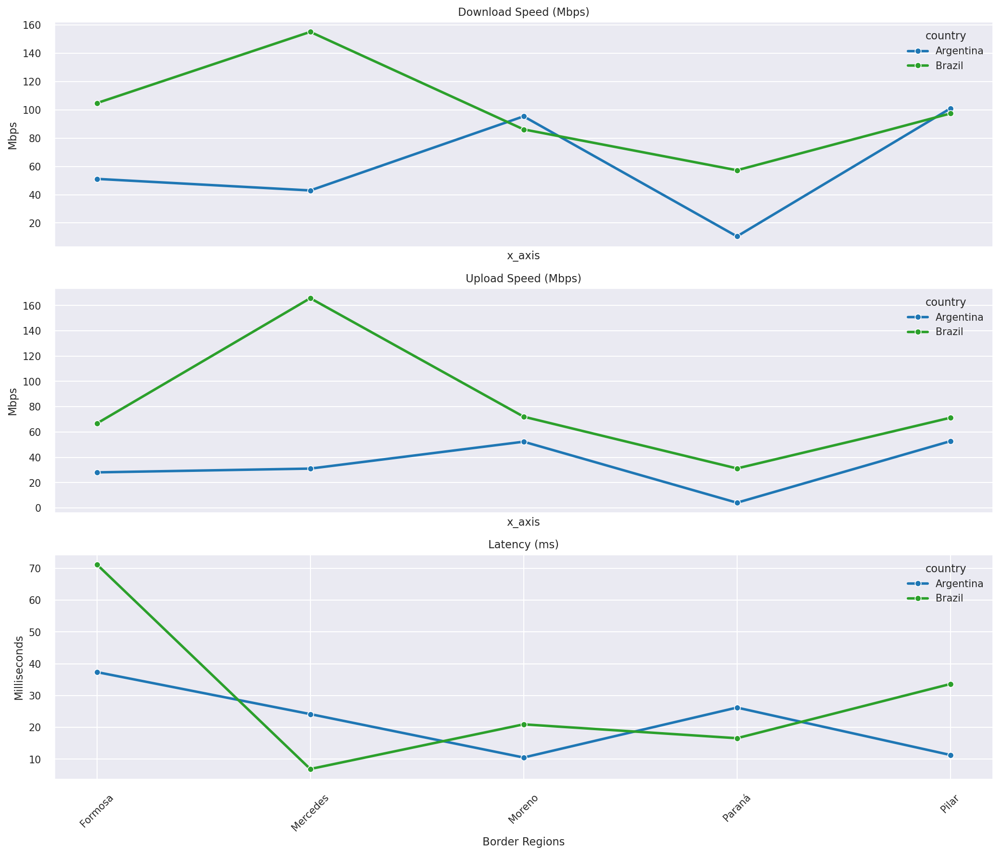

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

df = pd.read_csv('/content/Brazil_Argentina_Integrated.csv').copy()
df['avg_d_mbps'] = df['avg_d_kbps'] / 1000
df['avg_u_mbps'] = df['avg_u_kbps'] / 1000
df['avg_lat_ms'] = pd.to_numeric(df['avg_lat_ms'], errors='coerce')

brazil_regions = df[df['country'] == 'Brazil']['shapeName'].unique().tolist()
argentina_regions = df[df['country'] == 'Argentina']['shapeName'].unique().tolist()

border_regions = list(set(brazil_regions).intersection(set(argentina_regions)))

border_df = df[df['shapeName'].isin(border_regions)].copy()

trends = border_df.groupby(['country', 'shapeName']).agg({
    'avg_d_mbps': 'mean',
    'avg_u_mbps': 'mean',
    'avg_lat_ms': 'mean'
}).reset_index()

region_order = sorted(border_regions)
trends['x_axis'] = trends['shapeName'].map({r: i for i, r in enumerate(region_order)})

plt.figure(figsize=(14, 12))
sns.set_style("darkgrid")
palette = {'Brazil': '#2ca02c', 'Argentina': '#1f77b4'}

plt.subplot(3, 1, 1)
sns.lineplot(data=trends, x='x_axis', y='avg_d_mbps',
             hue='country', palette=palette, marker='o', linewidth=2.5)
plt.title('Download Speed (Mbps)')
plt.ylabel('Mbps')
plt.xticks([])

plt.subplot(3, 1, 2)
sns.lineplot(data=trends, x='x_axis', y='avg_u_mbps',
             hue='country', palette=palette, marker='o', linewidth=2.5)
plt.title('Upload Speed (Mbps)')
plt.ylabel('Mbps')
plt.xticks([])

plt.subplot(3, 1, 3)
sns.lineplot(data=trends, x='x_axis', y='avg_lat_ms',
             hue='country', palette=palette, marker='o', linewidth=2.5)
plt.title('Latency (ms)')
plt.ylabel('Milliseconds')
plt.xlabel('Border Regions')
plt.xticks(ticks=range(len(region_order)),
           labels=region_order, rotation=45)

plt.tight_layout()
plt.show()


## **3. Clustered Bar Chart**

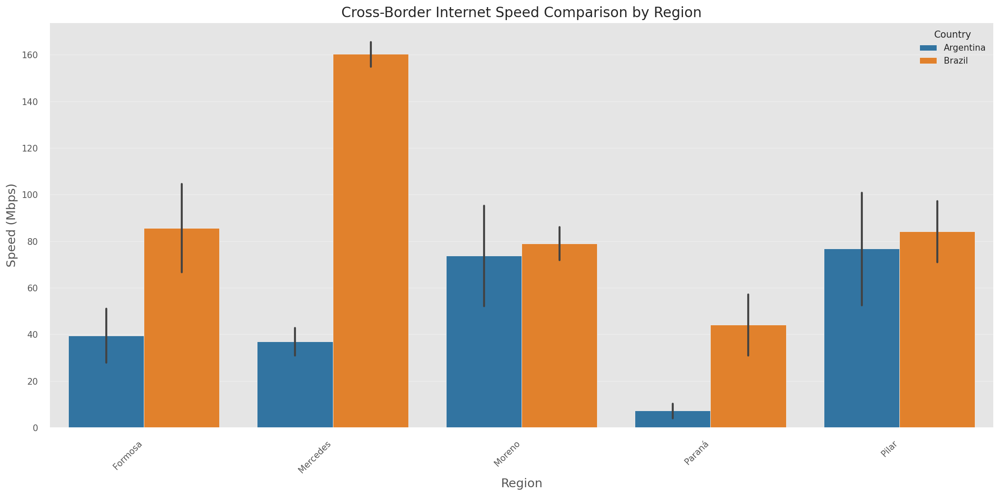

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = (16, 8)
sns.set_palette("Set2")

df = pd.read_csv('Brazil_Argentina_Integrated.csv')

df['avg_d_mbps'] = pd.to_numeric(df['avg_d_kbps'], errors='coerce') / 1000
df['avg_u_mbps'] = pd.to_numeric(df['avg_u_kbps'], errors='coerce') / 1000

brazil_regions = df.loc[df['country'] == 'Brazil', 'shapeName'].unique().tolist()
argentina_regions = df.loc[df['country'] == 'Argentina', 'shapeName'].unique().tolist()

border_regions = list(set(brazil_regions).intersection(set(argentina_regions)))

border_df = df[df['shapeName'].isin(border_regions)].copy()

agg_df = border_df.groupby(['country', 'shapeName']).agg({
    'avg_d_mbps': 'mean',
    'avg_u_mbps': 'mean'
}).reset_index()

speed_df = pd.melt(
    agg_df,
    id_vars=['country', 'shapeName'],
    value_vars=['avg_d_mbps', 'avg_u_mbps'],
    var_name='Metric',
    value_name='Speed (Mbps)'
)

speed_df['Metric'] = speed_df['Metric'].map({
    'avg_d_mbps': 'Download Speed',
    'avg_u_mbps': 'Upload Speed'
})

plt.figure(figsize=(16, 8))
sns.barplot(
    data=speed_df,
    x='shapeName',
    y='Speed (Mbps)',
    hue='country',
    palette=['#1f77b4', '#ff7f0e'],
    hue_order=['Argentina', 'Brazil'],
    dodge=True
)

plt.title('Cross-Border Internet Speed Comparison by Region', fontsize=16)
plt.xlabel('Region', fontsize=14)
plt.ylabel('Speed (Mbps)', fontsize=14)
plt.xticks(rotation=45, ha='right')
plt.legend(title='Country')
plt.grid(axis='y', alpha=0.3)
plt.tight_layout()
plt.show()


## **4. Scatter Plot**

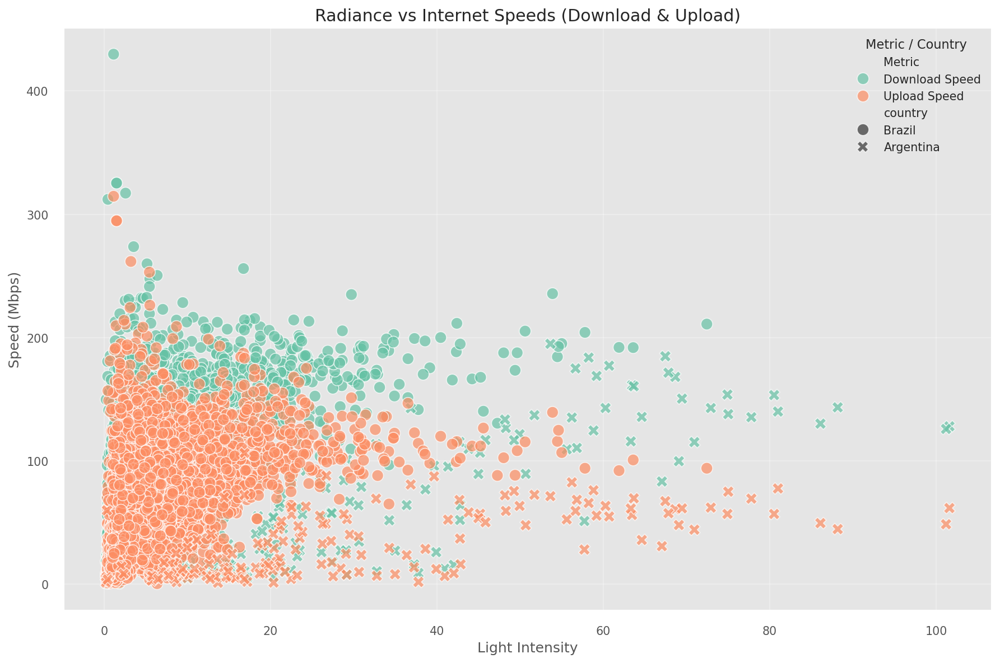

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

df = pd.read_csv('/content/Brazil_Argentina_Integrated.csv')

df['avg_d_kbps'] = pd.to_numeric(df['avg_d_kbps'], errors='coerce')
df['avg_u_kbps'] = pd.to_numeric(df['avg_u_kbps'], errors='coerce')
df['light_intensity'] = pd.to_numeric(df['light_intensity'], errors='coerce')

df_filtered = df.dropna(subset=['light_intensity'])
df_filtered = df_filtered[df_filtered['country'].isin(['Brazil', 'Argentina'])]

df_filtered['avg_d_mbps'] = df_filtered['avg_d_kbps'] / 1000
df_filtered['avg_u_mbps'] = df_filtered['avg_u_kbps'] / 1000

long = df_filtered.melt(
    id_vars=['light_intensity', 'country'],
    value_vars=['avg_d_mbps', 'avg_u_mbps'],
    var_name='Metric',
    value_name='Speed_Mbps'
)

long['Metric'] = long['Metric'].map({
    'avg_d_mbps': 'Download Speed',
    'avg_u_mbps': 'Upload Speed'
})

plt.figure(figsize=(12, 8))
sns.scatterplot(
    data=long,
    x='light_intensity',
    y='Speed_Mbps',
    hue='Metric',
    style='country',
    alpha=0.7,
    s=100
)

plt.xlabel("Light Intensity")
plt.ylabel("Speed (Mbps)")
plt.title("Radiance vs Internet Speeds (Download & Upload)")
plt.legend(title="Metric / Country")
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()


## **5. Geospatial Overlay**

In [ ]:
import pandas as pd
import geopandas as gpd
import folium

df = pd.read_csv('/content/Brazil_Argentina_Integrated.csv')
df['avg_d_kbps'] = pd.to_numeric(df['avg_d_kbps'], errors='coerce')
df['avg_u_kbps'] = pd.to_numeric(df['avg_u_kbps'], errors='coerce')
df['light_intensity'] = pd.to_numeric(df['light_intensity'], errors='coerce')

brazil_gdf = gpd.read_file('/content/geoBoundaries-BRA-ADM2.geojson')
argentina_gdf = gpd.read_file('/content/geoBoundaries-ARG-ADM2.geojson')

geo_gdf = pd.concat([brazil_gdf, argentina_gdf], ignore_index=True)

merged_gdf = geo_gdf.merge(df, on='shapeName')

merged_gdf['geometry'] = merged_gdf['geometry'].simplify(tolerance=0.01, preserve_topology=True)

m = folium.Map(location=[-27.0, -57.5], zoom_start=6)

def light_color(intensity):
    if pd.isna(intensity):
        return "gray"
    elif intensity > 20:
        return "yellow"
    elif intensity > 5:
        return "orange"
    else:
        return "red"

for _, row in merged_gdf.iterrows():
    color = light_color(row['light_intensity'])

    folium.GeoJson(
        row['geometry'],
        style_function=lambda x, fill=color: {
            'fillColor': fill,
            'color': 'black',
            'weight': 1,
            'fillOpacity': 0.6,
        }
    ).add_to(m)

    centroid = row['geometry'].centroid
    popup_html = (
        f"<b>{row['shapeName']} ({row['country']})</b><br>"
        f"Download: {row['avg_d_kbps']:.1f} kbps<br>"
        f"Upload: {row['avg_u_kbps']:.1f} kbps<br>"
        f"Light Intensity: {row['light_intensity']:.2f}"
    )
    folium.Marker(
        [centroid.y, centroid.x],
        popup=folium.Popup(popup_html, max_width=300),
        icon=folium.Icon(color='blue', icon='info-sign')
    ).add_to(m)

legend_html = '''
<div style="
    position: fixed; bottom: 50px; left: 50px; width: 180px; height: 120px;
    border: 2px solid grey; background-color: white; z-index: 9999; font-size: 14px;
    padding: 10px;">
    <b>Light Intensity (Radiance)</b><br>
    <i style="background:yellow; width:15px; height:15px; display:inline-block;"></i> > 20<br>
    <i style="background:orange; width:15px; height:15px; display:inline-block;"></i> 5 - 20<br>
    <i style="background:red; width:15px; height:15px; display:inline-block;"></i> < 5<br>
    <i style="background:gray; width:15px; height:15px; display:inline-block;"></i> No data
</div>
'''
m.get_root().html.add_child(folium.Element(legend_html))

m.save("brazil_argentina_border_internet_radiance_map.html")
print("Interactive map saved as brazil_argentina_border_internet_radiance_map.html")

Interactive map saved as brazil_argentina_border_internet_radiance_map.html


In [ ]:
display(m)

## Multiple Linear Regression

In [ ]:
import pandas as pd
import statsmodels.formula.api as smf

df = pd.read_csv('/content/Brazil_Argentina_Integrated.csv')

df['avg_d_mbps'] = df['avg_d_kbps'] / 1000
df = df.dropna(subset=['avg_d_mbps', 'light_intensity'])

if 'is_brazil' not in df.columns:
    df['is_brazil'] = (df['country'] == 'Brazil').astype(int)

model = smf.ols(formula="""
    avg_d_mbps ~ light_intensity + is_brazil + light_intensity:is_brazil
""", data=df).fit()

print(model.summary())


                            OLS Regression Results                            
Dep. Variable:             avg_d_mbps   R-squared:                       0.313
Model:                            OLS   Adj. R-squared:                  0.312
Method:                 Least Squares   F-statistic:                     805.8
Date:                Tue, 27 May 2025   Prob (F-statistic):               0.00
Time:                        20:42:09   Log-Likelihood:                -26943.
No. Observations:                5315   AIC:                         5.389e+04
Df Residuals:                    5311   BIC:                         5.392e+04
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                                coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------
Intercept             

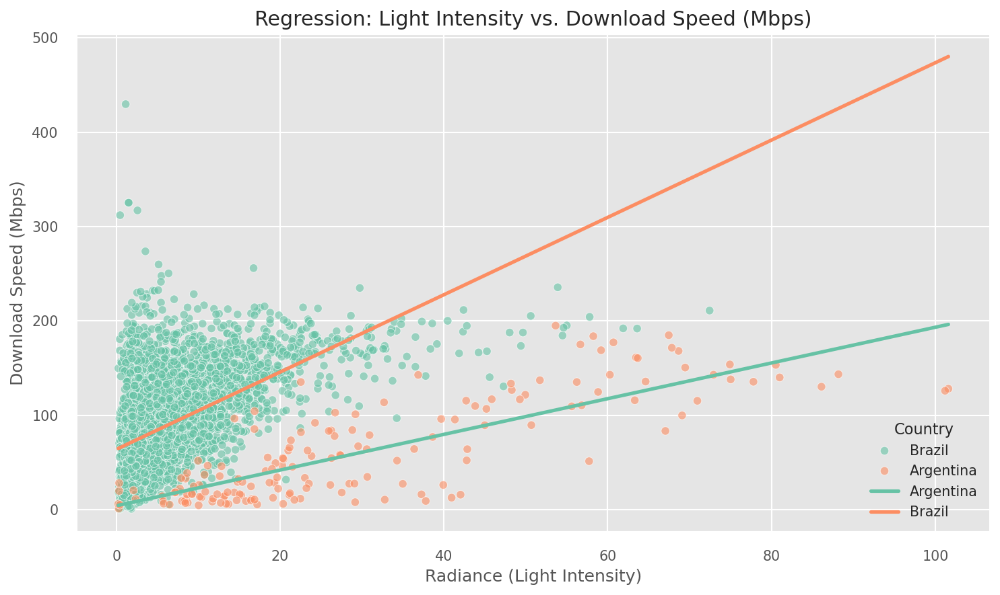

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.formula.api as smf
import numpy as np

df = pd.read_csv('/content/Brazil_Argentina_Integrated.csv')
df['avg_d_mbps'] = df['avg_d_kbps'] / 1000
df.dropna(subset=['avg_d_mbps', 'light_intensity'], inplace=True)
df['is_brazil'] = (df['country'] == 'Brazil').astype(int)

model = smf.ols(formula="""
    avg_d_mbps ~ light_intensity + is_brazil + light_intensity:is_brazil
""", data=df).fit()

light_range = np.linspace(df['light_intensity'].min(), df['light_intensity'].max(), 100)

pred_data = pd.DataFrame({
    'light_intensity': list(light_range) * 2,
    'is_brazil': [0]*100 + [1]*100
})
pred_data['country'] = ['Argentina']*100 + ['Brazil']*100

pred_data['predicted_d_mbps'] = model.predict(pred_data)

plt.figure(figsize=(10, 6))
sns.scatterplot(data=df, x='light_intensity', y='avg_d_mbps', hue='country', alpha=0.6)
sns.lineplot(data=pred_data, x='light_intensity', y='predicted_d_mbps', hue='country', linewidth=2.5)

plt.title('Regression: Light Intensity vs. Download Speed (Mbps)')
plt.xlabel('Radiance (Light Intensity)')
plt.ylabel('Download Speed (Mbps)')
plt.legend(title='Country')
plt.grid(True)
plt.tight_layout()
plt.show()

## Hypothesis Testing

In [ ]:
import pandas as pd
from scipy.stats import ttest_ind

df = pd.read_csv('/content/Brazil_Argentina_Integrated.csv')

df['avg_d_kbps'] = pd.to_numeric(df['avg_d_kbps'], errors='coerce')
df['avg_u_kbps'] = pd.to_numeric(df['avg_u_kbps'], errors='coerce')
df['avg_lat_ms'] = pd.to_numeric(df['avg_lat_ms'], errors='coerce')

df = df[df['country'].isin(['Brazil', 'Argentina'])]

df = df.dropna(subset=['avg_d_kbps', 'avg_u_kbps', 'avg_lat_ms'])

brazil = df[df['country'] == 'Brazil']
argentina = df[df['country'] == 'Argentina']

print("=== Hypothesis Testing Between Brazil and Argentina ===")

t_d, p_d = ttest_ind(brazil['avg_d_kbps'], argentina['avg_d_kbps'], equal_var=False)
print(f"\nDownload Speed:")
print(f"T-statistic = {t_d:.3f}, p-value = {p_d:.4f}")
print("→", "Reject H₀" if p_d < 0.05 else "Fail to reject H₀")

t_u, p_u = ttest_ind(brazil['avg_u_kbps'], argentina['avg_u_kbps'], equal_var=False)
print(f"\nUpload Speed:")
print(f"T-statistic = {t_u:.3f}, p-value = {p_u:.4f}")
print("→", "Reject H₀" if p_u < 0.05 else "Fail to reject H₀")

t_l, p_l = ttest_ind(brazil['avg_lat_ms'], argentina['avg_lat_ms'], equal_var=False)
print(f"\nLatency:")
print(f"T-statistic = {t_l:.3f}, p-value = {p_l:.4f}")
print("→", "Reject H₀" if p_l < 0.05 else "Fail to reject H₀")


=== Hypothesis Testing Between Brazil and Argentina ===

Download Speed:
T-statistic = 6.241, p-value = 0.0000
→ Reject H₀

Upload Speed:
T-statistic = 15.997, p-value = 0.0000
→ Reject H₀

Latency:
T-statistic = 3.007, p-value = 0.0029
→ Reject H₀


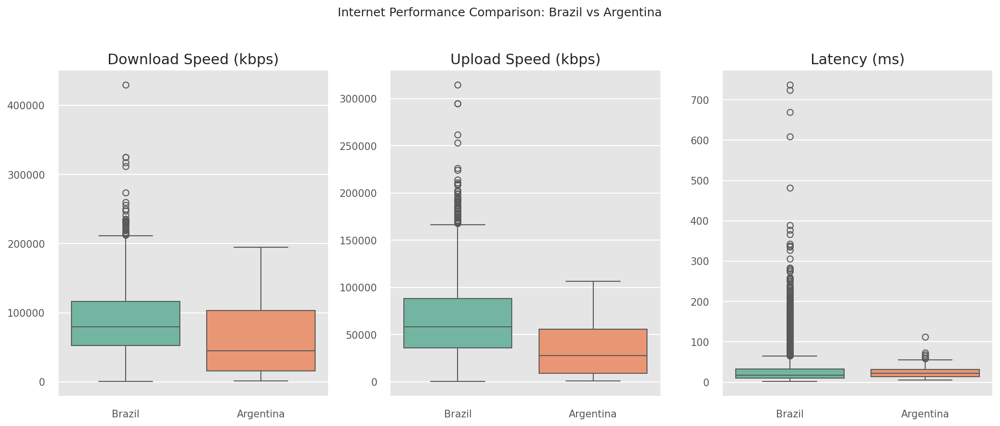

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(14, 6))

metrics = ['avg_d_kbps', 'avg_u_kbps', 'avg_lat_ms']
titles = ['Download Speed (kbps)', 'Upload Speed (kbps)', 'Latency (ms)']

for i, metric in enumerate(metrics, 1):
    plt.subplot(1, 3, i)
    sns.boxplot(
        data=df,
        x='country',
        y=metric,
        hue='country',
        palette='Set2',
        dodge=False
    )
    plt.legend([],[], frameon=False)
    plt.title(titles[i-1])
    plt.xlabel('')
    plt.ylabel('')

plt.suptitle('Internet Performance Comparison: Brazil vs Argentina')
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()


## Prediction Model Objective

                            OLS Regression Results                            
Dep. Variable:             avg_d_mbps   R-squared:                       0.313
Model:                            OLS   Adj. R-squared:                  0.312
Method:                 Least Squares   F-statistic:                     805.8
Date:                Tue, 27 May 2025   Prob (F-statistic):               0.00
Time:                        20:53:56   Log-Likelihood:                -26943.
No. Observations:                5315   AIC:                         5.389e+04
Df Residuals:                    5311   BIC:                         5.392e+04
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                                coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------
Intercept             

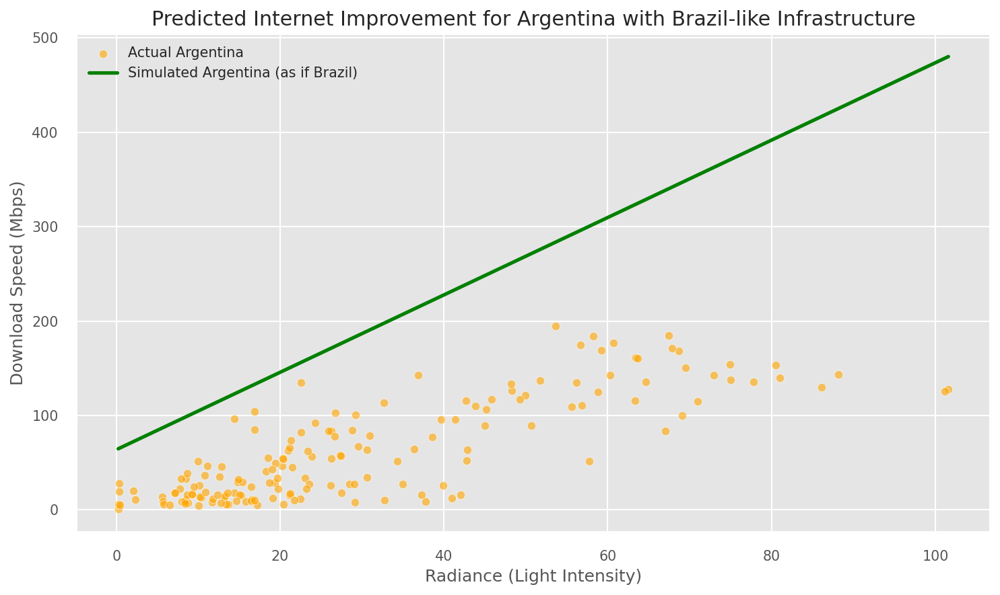

Average predicted improvement for Argentina (in Mbps): 127.08


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.formula.api as smf
import numpy as np

df = pd.read_csv('/content/Brazil_Argentina_Integrated.csv')

df['avg_d_mbps'] = pd.to_numeric(df['avg_d_kbps'], errors='coerce') / 1000
df['light_intensity'] = pd.to_numeric(df['light_intensity'], errors='coerce')

df.dropna(subset=['avg_d_mbps', 'light_intensity'], inplace=True)

df['is_brazil'] = (df['country'] == 'Brazil').astype(int)

model = smf.ols(formula="""
    avg_d_mbps ~ light_intensity + is_brazil + light_intensity:is_brazil
""", data=df).fit()

print(model.summary())

b0 = model.params['Intercept']
b_light = model.params['light_intensity']
b_brazil = model.params['is_brazil']
b_interaction = model.params['light_intensity:is_brazil']

slope_brazil = b_light + b_interaction

arg_df = df[df['country'] == 'Argentina'].copy()

arg_df['predicted_as_brazil'] = (b0 + b_brazil) + slope_brazil * arg_df['light_intensity']

plt.figure(figsize=(10, 6))

sns.scatterplot(data=arg_df, x='light_intensity', y='avg_d_mbps', label='Actual Argentina', color='orange', alpha=0.6)

sns.lineplot(data=arg_df.sort_values('light_intensity'), x='light_intensity', y='predicted_as_brazil',
             label='Simulated Argentina (as if Brazil)', color='green', linewidth=2.5)

plt.title('Predicted Internet Improvement for Argentina with Brazil-like Infrastructure')
plt.xlabel('Radiance (Light Intensity)')
plt.ylabel('Download Speed (Mbps)')
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

arg_df['improvement_mbps'] = arg_df['predicted_as_brazil'] - arg_df['avg_d_mbps']
print("Average predicted improvement for Argentina (in Mbps):", round(arg_df['improvement_mbps'].mean(), 3))
